In [ ]:
!wget https://www.dropbox.com/scl/fi/pavp15rsgzkzz7vu4mmyn/archive.zip?rlkey=rm6z7zdilegqffd73lpe7d25r&dl=0

!unzip /content/archive.zip?rlkey=rm6z7zdilegqffd73lpe7d25r -d /content/Dataset

--2024-04-20 10:32:04--  https://www.dropbox.com/scl/fi/pavp15rsgzkzz7vu4mmyn/archive.zip?rlkey=rm6z7zdilegqffd73lpe7d25r
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://ucb39b2321b7aea7626aab7841eb.dl.dropboxusercontent.com/cd/0/inline/CRanExVVHiGmhQHzjQAH2IaR2WZqwtX3uyigBTWppYvhMJ6MszwLXcBgHxP0Hs8rba9tDY3ndWHc1ZZj2oTdV8kFMRW8VuckXc9lKPpneZCogK2aDCEGTDHnvPgWxMXE_56H4Hiy0U0F27xVqkr7jQnX/file# [following]
--2024-04-20 10:32:05--  https://ucb39b2321b7aea7626aab7841eb.dl.dropboxusercontent.com/cd/0/inline/CRanExVVHiGmhQHzjQAH2IaR2WZqwtX3uyigBTWppYvhMJ6MszwLXcBgHxP0Hs8rba9tDY3ndWHc1ZZj2oTdV8kFMRW8VuckXc9lKPpneZCogK2aDCEGTDHnvPgWxMXE_56H4Hiy0U0F27xVqkr7jQnX/file
Resolving ucb39b2321b7aea7626aab7841eb.dl.dropboxusercontent.com (ucb39b2321b7aea7626aab7841eb.dl.dropboxusercontent.com)... 162.125.3.15, 2620:10

In [ ]:
import pathlib
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import PIL
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from keras.layers import Conv2D,Dense,Flatten,MaxPooling2D, Dropout, BatchNormalization

In [ ]:
data_dir_train = pathlib.Path("/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train")
data_dir_test = pathlib.Path("/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Test")

In [ ]:
batch_size = 32
img_height = 228
img_width = 228

In [ ]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir_train,
  seed=123,
  validation_split = 0.2,
  subset = 'training',
  image_size=(img_height, img_width),
  batch_size=batch_size)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir_train,
  seed=123,
  validation_split = 0.2,
  subset = 'validation',
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 2239 files belonging to 9 classes.
Using 1792 files for training.
Found 2239 files belonging to 9 classes.
Using 447 files for validation.


In [ ]:
# List out all the classes of skin cancer and store them in a list.
# You can find the class names in the class_names attribute on these datasets.
# These correspond to the directory names in alphabetical order.
class_names = train_ds.class_names
print(class_names)

['actinic keratosis', 'basal cell carcinoma', 'dermatofibroma', 'melanoma', 'nevus', 'pigmented benign keratosis', 'seborrheic keratosis', 'squamous cell carcinoma', 'vascular lesion']


In [ ]:
from keras.callbacks import ModelCheckpoint, EarlyStopping

# es = EarlyStopping(monitor = "val_accuracy", min_delta = 0.01, patience = 10, verbose = 1, mode = 'auto')

es = EarlyStopping(monitor = "val_loss", patience = 10, verbose = 1, mode = 'auto',restore_best_weights=True)

mc = ModelCheckpoint(monitor = "val_accuracy", min_delta = 0.01, filepath = "./bestmodel.h5",verbose = 1, save_best_only = True, mode = 'auto')

cd = [es,mc]

In [ ]:
## Your code goes here.
from glob import glob
path_list = [x for x in glob(os.path.join(data_dir_train, '*', '*.jpg'))]
lesion_list = [os.path.basename(os.path.dirname(y)) for y in glob(os.path.join(data_dir_train, '*', '*.jpg'))]
len(path_list)

2239

In [ ]:
dataframe_dict_original = dict(zip(path_list, lesion_list))
original_df = pd.DataFrame(list(dataframe_dict_original.items()),columns = ['Path','Label'])
original_df

,Path,Label
0,/content/Dataset/Skin cancer ISIC The Internat...,vascular lesion
1,/content/Dataset/Skin cancer ISIC The Internat...,vascular lesion
2,/content/Dataset/Skin cancer ISIC The Internat...,vascular lesion
3,/content/Dataset/Skin cancer ISIC The Internat...,vascular lesion
4,/content/Dataset/Skin cancer ISIC The Internat...,vascular lesion
...,...,...
2234,/content/Dataset/Skin cancer ISIC The Internat...,actinic keratosis
2235,/content/Dataset/Skin cancer ISIC The Internat...,actinic keratosis
2236,/content/Dataset/Skin cancer ISIC The Internat...,actinic keratosis
2237,/content/Dataset/Skin cancer ISIC The Internat...,actinic keratosis


Class=8, n=139 (6.208%)
Class=4, n=357 (15.945%)
Class=7, n=181 (8.084%)
Class=6, n=77 (3.439%)
Class=1, n=376 (16.793%)
Class=2, n=95 (4.243%)
Class=3, n=438 (19.562%)
Class=5, n=462 (20.634%)
Class=0, n=114 (5.092%)


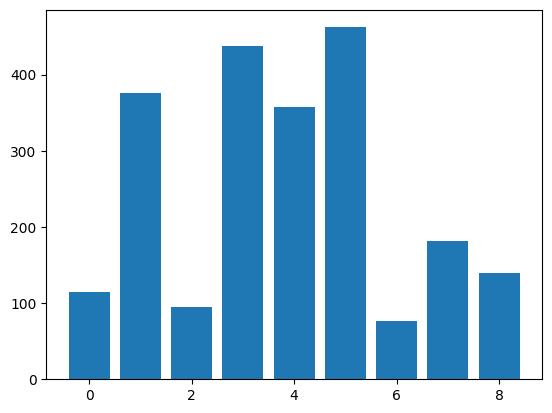

In [ ]:
from sklearn.preprocessing import LabelEncoder
from collections import Counter
# split into input and output elements
X, y = original_df['Path'], original_df['Label']
# label encode the target variable
y = LabelEncoder().fit_transform(y)
# summarize distribution
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
plt.bar(counter.keys(), counter.values())
plt.show()


In [ ]:
!pip install Augmentor

In [ ]:
datapath = r'/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis'
import Augmentor
p = Augmentor.Pipeline(datapath)
#Every function requires you to specify a probability, which is used to decide if an operation is applied to an image as it is passed through the augmentation pipeline.
p.rotate(probability=0.7, max_left_rotation=10, max_right_rotation=10)
p.zoom(probability=0.5, min_factor=1.1, max_factor=1.5)
p.sample(150)
p.process()

Initialised with 114 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD561350130>: 100%|██████████| 150/150 [00:04<00:00, 30.07 Samples/s]
Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD56142AD70>: 100%|██████████| 114/114 [00:04<00:00, 23.80 Samples/s]


In [ ]:
path_to_training_dataset="/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//"
import Augmentor
class_names = train_ds.class_names
print(class_names)
for i in class_names:
    p = Augmentor.Pipeline(path_to_training_dataset + i)
    p.rotate(probability=0.7, max_left_rotation=10, max_right_rotation=10)
    p.sample(500) ## We are adding 500 samples per class to make sure that none of the classes are sparse.

['actinic keratosis', 'basal cell carcinoma', 'dermatofibroma', 'melanoma', 'nevus', 'pigmented benign keratosis', 'seborrheic keratosis', 'squamous cell carcinoma', 'vascular lesion']
Initialised with 114 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//actinic keratosis/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD5613A1270>: 100%|██████████| 500/500 [00:17<00:00, 28.26 Samples/s]


Initialised with 376 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//basal cell carcinoma/output.

Processing <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=600x450 at 0x7FD56031EEF0>: 100%|██████████| 500/500 [00:18<00:00, 27.65 Samples/s]


Initialised with 95 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//dermatofibroma/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD5613A3760>: 100%|██████████| 500/500 [00:20<00:00, 24.55 Samples/s]


Initialised with 438 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//melanoma/output.

Processing <PIL.Image.Image image mode=RGB size=3072x2304 at 0x7FD56142AE60>: 100%|██████████| 500/500 [01:25<00:00,  5.84 Samples/s]


Initialised with 357 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//nevus/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD55F97A5F0>: 100%|██████████| 500/500 [01:23<00:00,  6.02 Samples/s]


Initialised with 462 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//pigmented benign keratosis/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD5E5CF9330>: 100%|██████████| 500/500 [00:15<00:00, 31.95 Samples/s]


Initialised with 77 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//seborrheic keratosis/output.

Processing <PIL.Image.Image image mode=RGB size=1024x768 at 0x7FD560301390>: 100%|██████████| 500/500 [00:32<00:00, 15.22 Samples/s]


Initialised with 181 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//squamous cell carcinoma/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD55F952860>: 100%|██████████| 500/500 [00:13<00:00, 36.06 Samples/s]


Initialised with 139 image(s) found.
Output directory set to /content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train//vascular lesion/output.

Processing <PIL.Image.Image image mode=RGB size=600x450 at 0x7FD56031E920>: 100%|██████████| 500/500 [00:14<00:00, 34.55 Samples/s]


In [ ]:
image_count_train = len(list(data_dir_train.glob('*/output/*.jpg')))
print(image_count_train)

4764


In [ ]:
path_list_new = [x for x in glob(os.path.join(data_dir_train, '*','output', '*.jpg'))]
path_list_new

['/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/output/vascular lesion_original_ISIC_0028188.jpg_e72bfb8e-feb5-4cc9-b352-4f89062d5aa9.jpg',
 '/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/output/vascular lesion_original_ISIC_0031901.jpg_dcef6693-9eb1-4c65-99a3-73e79b2d4850.jpg',
 '/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/output/vascular lesion_original_ISIC_0031093.jpg_a2071cf3-c9b9-4bca-8f69-a19e672ad6ee.jpg',
 '/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/output/vascular lesion_original_ISIC_0031950.jpg_b535a4d4-ede3-47b2-8d1a-4a9553e97a9a.jpg',
 '/content/Dataset/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/output/vascular lesion_original_ISIC_0026713.jpg_78fdbb1c-04f6-4851-aa93-7197cc6ed476.jpg',
 '/content/Dataset/Skin c

In [ ]:
lesion_list_new = [os.path.basename(os.path.dirname(os.path.dirname(y))) for y in glob(os.path.join(data_dir_train, '*','output', '*.jpg'))]
lesion_list_new

['vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',
 'vascular lesion',


In [ ]:
dataframe_dict_new = dict(zip(path_list_new, lesion_list_new))

In [ ]:
df2 = pd.DataFrame(list(dataframe_dict_new.items()),columns = ['Path','Label'])
new_df = pd.concat([original_df, df2], ignore_index=True)

In [ ]:
new_df['Label'].value_counts()

Label
pigmented benign keratosis    962
melanoma                      938
actinic keratosis             878
basal cell carcinoma          876
nevus                         857
squamous cell carcinoma       681
vascular lesion               639
dermatofibroma                595
seborrheic keratosis          577
Name: count, dtype: int64

#**Todo:** Train the model on the data created using Augmentor

In [ ]:
batch_size = 32
img_height = 228
img_width = 228

In [ ]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir_train,
  seed=123,
  validation_split = 0.2,
  subset = 'training', ## Todo choose the correct parameter value, so that only training data is refered to
  image_size=(img_height, img_width),
  batch_size=batch_size)

val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir_train,
  seed=123,
  validation_split = 0.2,
  subset = 'validation',## Todo choose the correct parameter value, so that only validation data is refered to,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 7003 files belonging to 9 classes.
Using 5603 files for training.
Found 7003 files belonging to 9 classes.
Using 1400 files for validation.


In [ ]:
print(class_names)

['actinic keratosis', 'basal cell carcinoma', 'dermatofibroma', 'melanoma', 'nevus', 'pigmented benign keratosis', 'seborrheic keratosis', 'squamous cell carcinoma', 'vascular lesion']


In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

model = Sequential([
  layers.experimental.preprocessing.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.BatchNormalization(),

  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.BatchNormalization(),

  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.BatchNormalization(),

  layers.Conv2D(128, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.BatchNormalization(),

  layers.Conv2D(256, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.BatchNormalization(),

  layers.Dropout(0.3),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(9, activation='softmax',kernel_regularizer = tf.keras.regularizers.l1_l2(l1=0.03, l2=0.05))
])

model.build(input_shape=(None, 228, 228, 3))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 228, 228, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 228, 228, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 114, 114, 16)      0         
 D)                                                              
                                                                 
 batch_normalization (Batch  (None, 114, 114, 16)      64        
 Normalization)                                                  
                                                                 
 conv2d_1 (Conv2D)           (None, 114, 114, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 57, 57, 32)        0

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

In [ ]:
epochs = 30
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs,
  callbacks=[ mc]
)

Epoch 1/30
176/176 [==============================] - ETA: 0s - loss: 4.2315 - accuracy: 0.4125
Epoch 1: val_accuracy improved from -inf to 0.11571, saving model to ./bestmodel.h5
176/176 [==============================] - 45s 90ms/step - loss: 4.2315 - accuracy: 0.4125 - val_loss: 4.7156 - val_accuracy: 0.1157
Epoch 2/30
  1/176 [..............................] - ETA: 8s - loss: 2.4316 - accuracy: 0.5000

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


176/176 [==============================] - ETA: 0s - loss: 1.6496 - accuracy: 0.5593
Epoch 2: val_accuracy improved from 0.11571 to 0.15071, saving model to ./bestmodel.h5
176/176 [==============================] - 10s 55ms/step - loss: 1.6496 - accuracy: 0.5593 - val_loss: 3.4331 - val_accuracy: 0.1507
Epoch 3/30
176/176 [==============================] - ETA: 0s - loss: 1.1132 - accuracy: 0.6661
Epoch 3: val_accuracy improved from 0.15071 to 0.47071, saving model to ./bestmodel.h5
176/176 [==============================] - 10s 56ms/step - loss: 1.1132 - accuracy: 0.6661 - val_loss: 1.6207 - val_accuracy: 0.4707
Epoch 4/30
176/176 [==============================] - ETA: 0s - loss: 0.8889 - accuracy: 0.7466
Epoch 4: val_accuracy improved from 0.47071 to 0.64714, saving model to ./bestmodel.h5
176/176 [==============================] - 10s 56ms/step - loss: 0.8889 - accuracy: 0.7466 - val_loss: 1.0911 - val_accuracy: 0.6471
Epoch 5/30
176/176 [==============================] - ETA: 0s -

In [ ]:
loss, accuracy = model.evaluate(train_ds, verbose=1,)
loss_v, accuracy_v = model.evaluate(val_ds, verbose=1)

print("Accuracy: ", accuracy)
print("Validation Accuracy: ",accuracy_v)
print("Loss: ",loss)
print("Validation Loss", loss_v)

44/44 [==============================] - 1s 13ms/step - loss: 0.6140 - accuracy: 0.8300
Accuracy:  0.9368195533752441
Validation Accuracy:  0.8299999833106995
Loss:  0.2582782208919525
Validation Loss 0.6139801740646362


In [ ]:
from tensorflow.keras.models import load_model
loaded_model = load_model('bestmodel.h5')

loss, accuracy = loaded_model.evaluate(train_ds, verbose=1,)
loss_v, accuracy_v = loaded_model.evaluate(val_ds, verbose=1)

print("Accuracy: ", accuracy)
print("Validation Accuracy: ",accuracy_v)
print("Loss: ",loss)
print("Validation Loss", loss_v)

44/44 [==============================] - 1s 13ms/step - loss: 0.5605 - accuracy: 0.8514
Accuracy:  0.938782811164856
Validation Accuracy:  0.8514285683631897
Loss:  0.30175095796585083
Validation Loss 0.5605058073997498


In [ ]:
!unzip /content/archive.zip?rlkey=rm6z7zdilegqffd73lpe7d25r -d /content/

Archive:  /content/archive.zip?rlkey=rm6z7zdilegqffd73lpe7d25r
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0010512.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0010889.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024468.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024470.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024511.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024646.jpg  
  inflating: /content/Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024654.jpg  
  inflating: /content/Skin cancer ISIC The Internationa

In [ ]:
# Define the directory containing test images
data_dir_test = pathlib.Path("/content/Skin cancer ISIC The International Skin Imaging Collaboration/Train")

# Define batch size, image height, and width
batch_size = 32
img_height = 228
img_width = 228

# Create the test dataset
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    data_dir_test,
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size,
    validation_split=0.2,  # Take 20% of the images for validation
    subset="validation"
)

# You may want to prefetch and cache the test dataset for better performance
test_ds = test_ds.cache().prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
# List out all the classes of skin cancer and store them in a list.
# You can find the class names in the class_names attribute on these datasets.
# These correspond to the directory names in alphabetical order.


Found 2239 files belonging to 9 classes.
Using 447 files for validation.


In [ ]:
# Evaluate the model on the test dataset
loss, accuracy = loaded_model.evaluate(test_ds)
print("Test Accuracy:", accuracy)
print("Test Loss:", loss)

14/14 [==============================] - 3s 114ms/step - loss: 0.3902 - accuracy: 0.9083
Test Accuracy: 0.9082773923873901
Test Loss: 0.39016538858413696


In [ ]:
# Evaluate the model on the test dataset
loss, accuracy = loaded_model.evaluate(test_ds)
print("Test Accuracy:", accuracy)
print("Test Loss:", loss)

14/14 [==============================] - 0s 17ms/step - loss: 0.3902 - accuracy: 0.9083
Test Accuracy: 0.9082773923873901
Test Loss: 0.39016538858413696


In [ ]:
# Evaluate the model on the test dataset
loss, accuracy = loaded_model.evaluate(test_ds)
print("Test Accuracy:", accuracy)
print("Test Loss:", loss)

14/14 [==============================] - 0s 17ms/step - loss: 0.3902 - accuracy: 0.9083
Test Accuracy: 0.9082773923873901
Test Loss: 0.39016538858413696


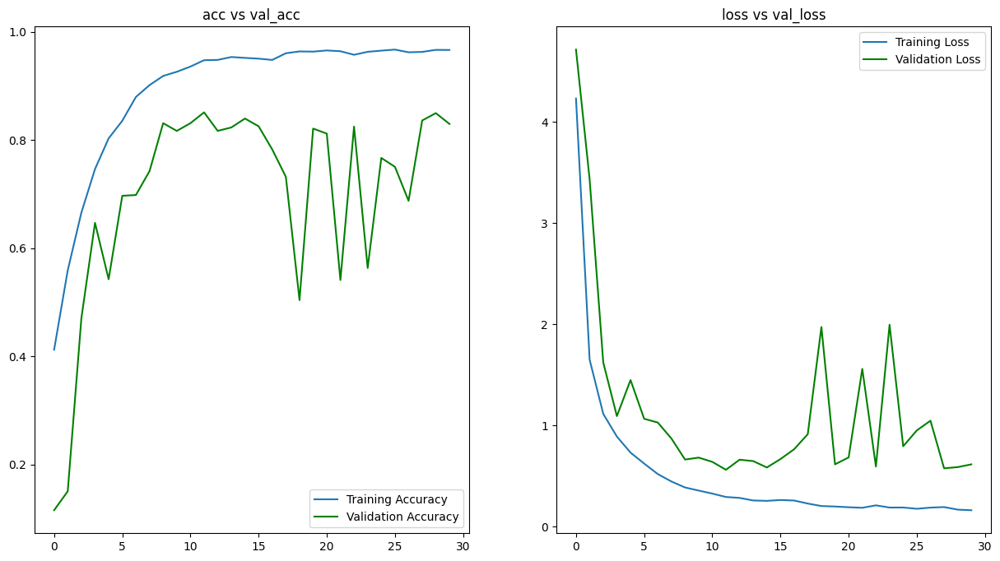

In [ ]:
h = history.history
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.plot(h['accuracy'], label='Training Accuracy')
plt.plot(h['val_accuracy'], c='green', label='Validation Accuracy')

plt.title("acc vs val_acc")
plt.legend(loc='lower right')
# plt.ylim(0, len(h['accuracy']))
# plt.yticks([i * 0.1 for i in range(13)])
#plt.show()

plt.subplot(1, 2, 2)
plt.plot(h['loss'],label='Training Loss')
plt.plot(h['val_loss'], c='green',label='Validation Loss')
# plt.yticks([i * 0.1 for i in range(20)])
plt.legend(loc='upper right')

plt.title("loss vs val_loss")
plt.show()

In [ ]:
yhat = loaded_model.predict(test_ds)
yhat

14/14 [==============================] - 0s 13ms/step


array([[5.4748944e-07, 3.4549758e-03, 1.3000593e-03, ..., 4.1081730e-06,
        3.0134877e-03, 9.8621076e-01],
       [6.0353154e-09, 1.0625301e-06, 1.2446309e-06, ..., 9.4989249e-05,
        4.7120542e-07, 6.7605612e-07],
       [2.1251915e-02, 8.3644938e-01, 2.4878645e-02, ..., 3.9311397e-04,
        7.7581895e-03, 7.5853080e-02],
       ...,
       [8.0003501e-06, 1.1520636e-05, 1.3552991e-06, ..., 3.9608724e-02,
        5.2078335e-06, 2.1032761e-06],
       [4.6572837e-05, 8.3606851e-01, 9.3188242e-04, ..., 6.5215485e-05,
        1.1351866e-03, 1.3658321e-01],
       [8.5145166e-06, 1.7157627e-05, 4.5567144e-06, ..., 2.8170443e-05,
        2.9831243e-04, 3.8788363e-07]], dtype=float32)

In [ ]:
# from keras.preprocessing import image

# img_path = '/content/Skin cancer ISIC The International Skin Imaging Collaboration/Train/dermatofibroma/ISIC_0029973.jpg'
# img = image.load_img(img_path, target_size=(img_height, img_width))

# # Preprocess the image
# x = image.img_to_array(img)
# x = np.expand_dims(x, axis=0)
# x = x / 255.0  # Rescale pixel values to [0, 1]

# # Make predictions using the trained model
# predictions = loaded_model.predict(x)
# predicted_class_index = np.argmax(predictions[0])
# predicted_class_name = class_names[predicted_class_index]
# print(predicted_class_name)

In [ ]:
# min_value = np.min(yhat)
# max_value = np.max(yhat)
# scaled_yhat = (yhat - min_value) / (max_value - min_value)

In [ ]:
# predicted_class_index = np.argmax(predictions[0])
# predicted_class_name = class_names[predicted_class_index]
# print(predicted_class_name)

In [ ]:
predicted_class_indices = np.argmax(yhat, axis=1)
# predicted_class_label = class_names[predicted_class_index]

predicted_class_names = [class_names[idx] for idx in predicted_class_indices]

# Print the predicted class names
for class_name in predicted_class_names:
    print(class_name)
# print("Predicted Class Label:", predicted_class_label, predicted_class_indices)

vascular lesion
nevus
basal cell carcinoma
dermatofibroma
basal cell carcinoma
nevus
pigmented benign keratosis
vascular lesion
nevus
vascular lesion
nevus
pigmented benign keratosis
pigmented benign keratosis
squamous cell carcinoma
melanoma
melanoma
melanoma
pigmented benign keratosis
nevus
nevus
pigmented benign keratosis
pigmented benign keratosis
basal cell carcinoma
basal cell carcinoma
basal cell carcinoma
seborrheic keratosis
vascular lesion
melanoma
basal cell carcinoma
melanoma
actinic keratosis
basal cell carcinoma
nevus
pigmented benign keratosis
pigmented benign keratosis
pigmented benign keratosis
basal cell carcinoma
nevus
melanoma
pigmented benign keratosis
basal cell carcinoma
nevus
squamous cell carcinoma
basal cell carcinoma
basal cell carcinoma
nevus
basal cell carcinoma
pigmented benign keratosis
basal cell carcinoma
pigmented benign keratosis
actinic keratosis
seborrheic keratosis
basal cell carcinoma
squamous cell carcinoma
dermatofibroma
pigmented benign keratos

In [ ]:
def display_image_with_class(image, class_name):
    plt.figure()
    plt.imshow(image)
    plt.title("Predicted Class: " + class_name)
    plt.axis('off')
    plt.show()

In [ ]:
import os
import matplotlib.pyplot as plt

1/1 [==============================] - 0s 205ms/step


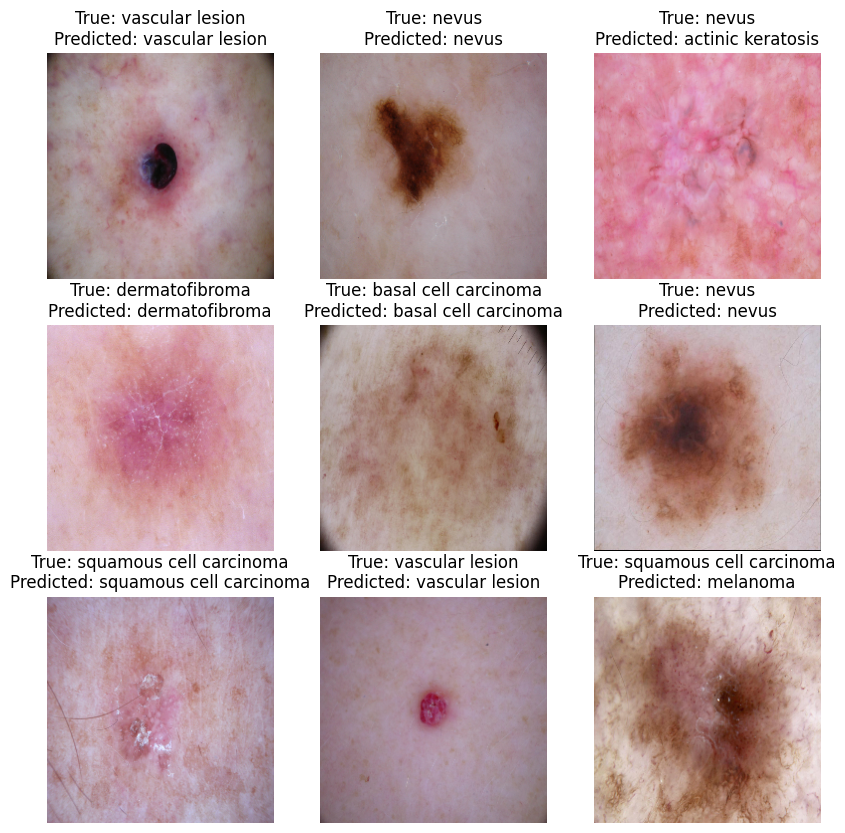

In [ ]:
plt.figure(figsize=(10, 10))
for images, true_labels in test_ds.take(1):  # Take the first batch of images
    predicted_class_indices = model.predict(images)  # Predict the labels for the images
    for i in range(9):  # Display only 9 images to fit the subplot layout
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        true_label = class_names[true_labels[i].numpy()]
        predicted_label = class_names[np.argmax(predicted_class_indices[i])]
        plt.title(f"True: {true_label}\nPredicted: {predicted_label}")
        plt.axis("off")
plt.show()

1/1 [==============================] - 0s 258ms/step


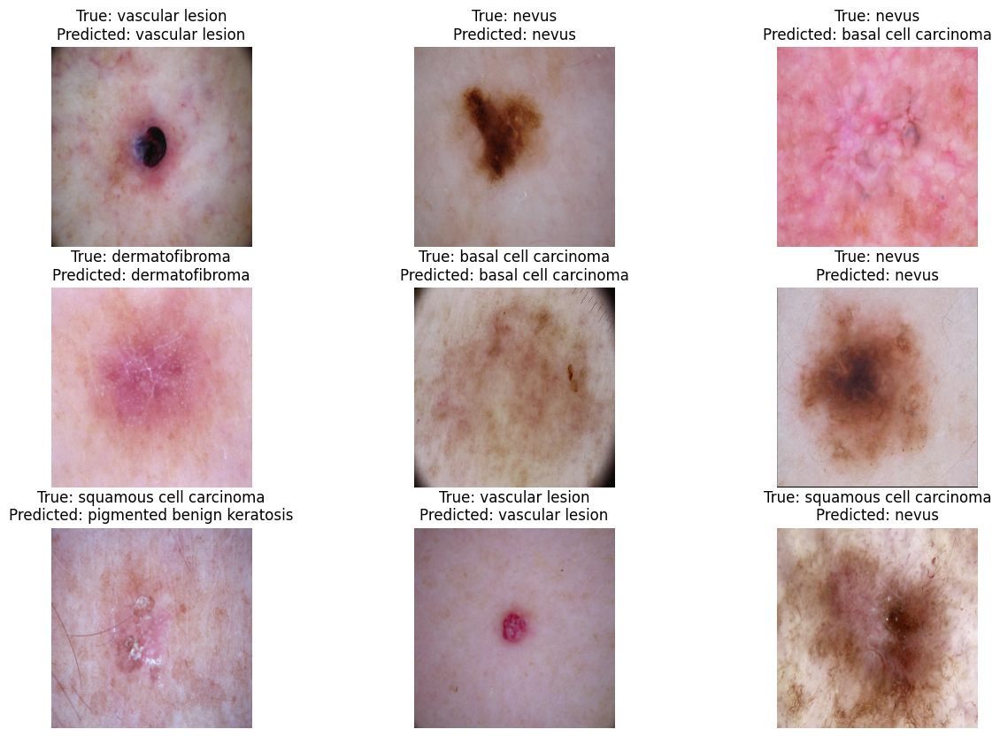

1/1 [==============================] - 0s 33ms/step


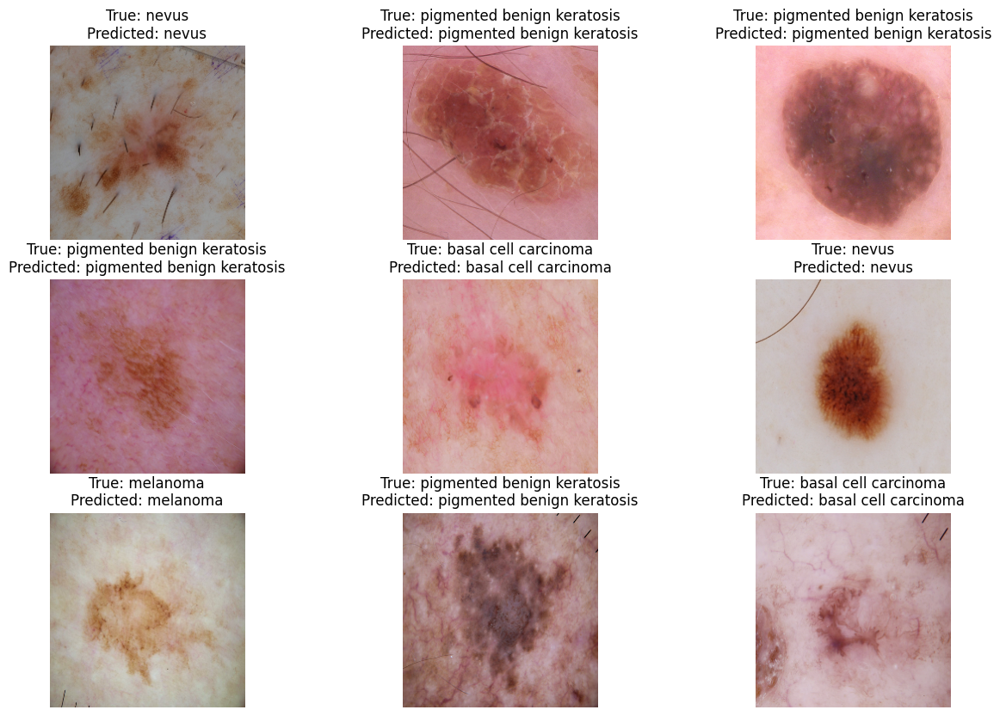

1/1 [==============================] - 0s 53ms/step


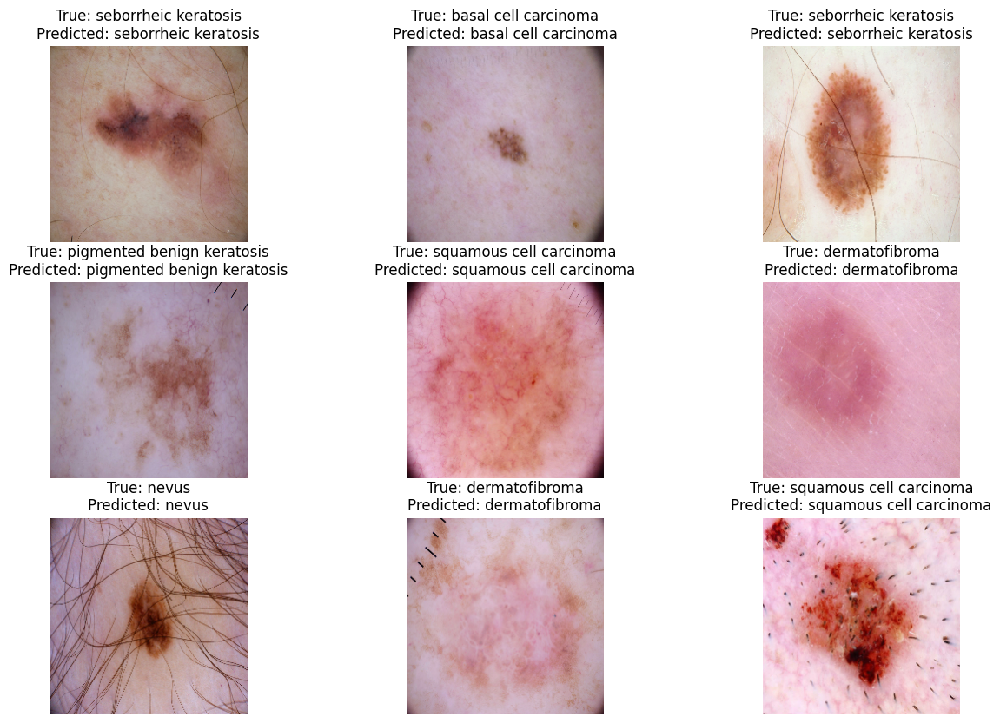

1/1 [==============================] - 0s 41ms/step


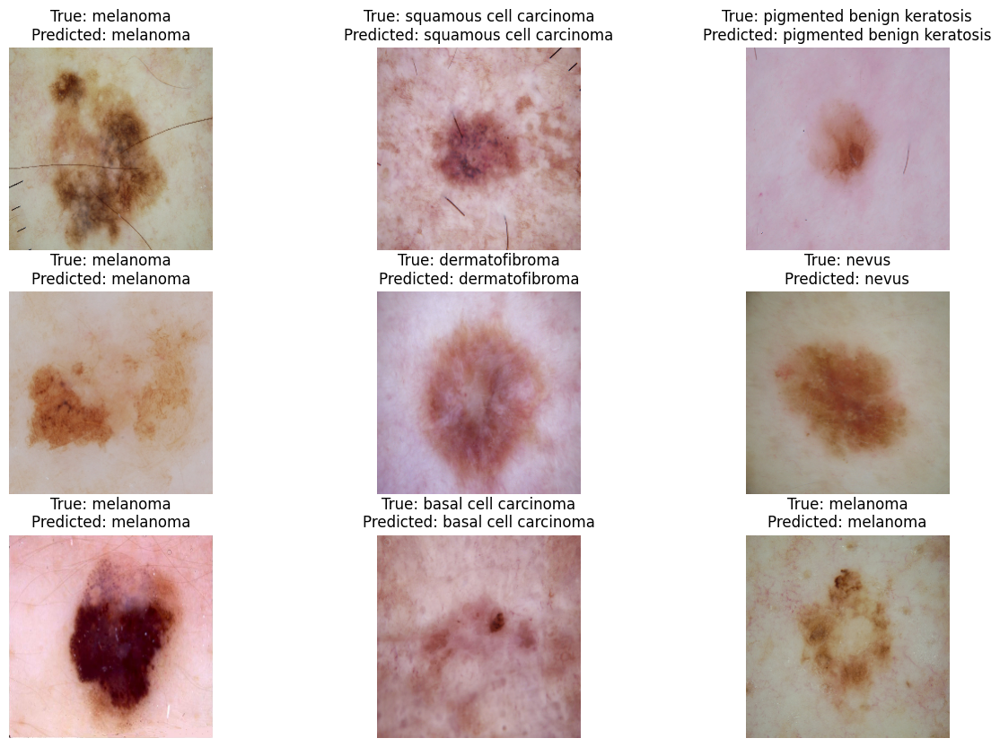

1/1 [==============================] - 0s 33ms/step


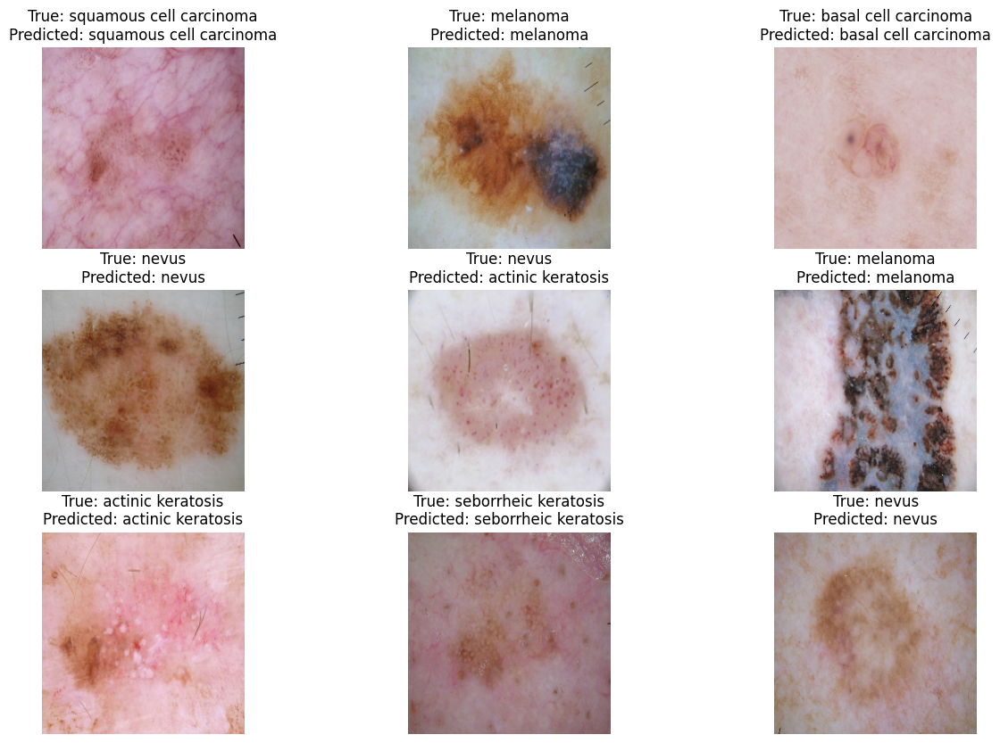

1/1 [==============================] - 0s 44ms/step


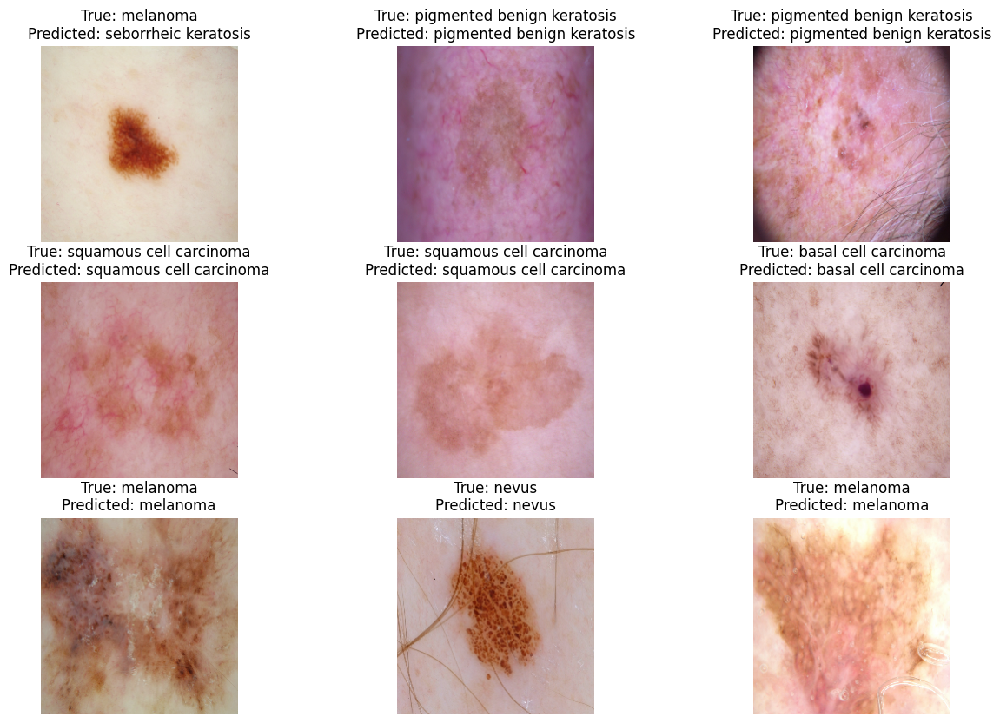

1/1 [==============================] - 0s 33ms/step


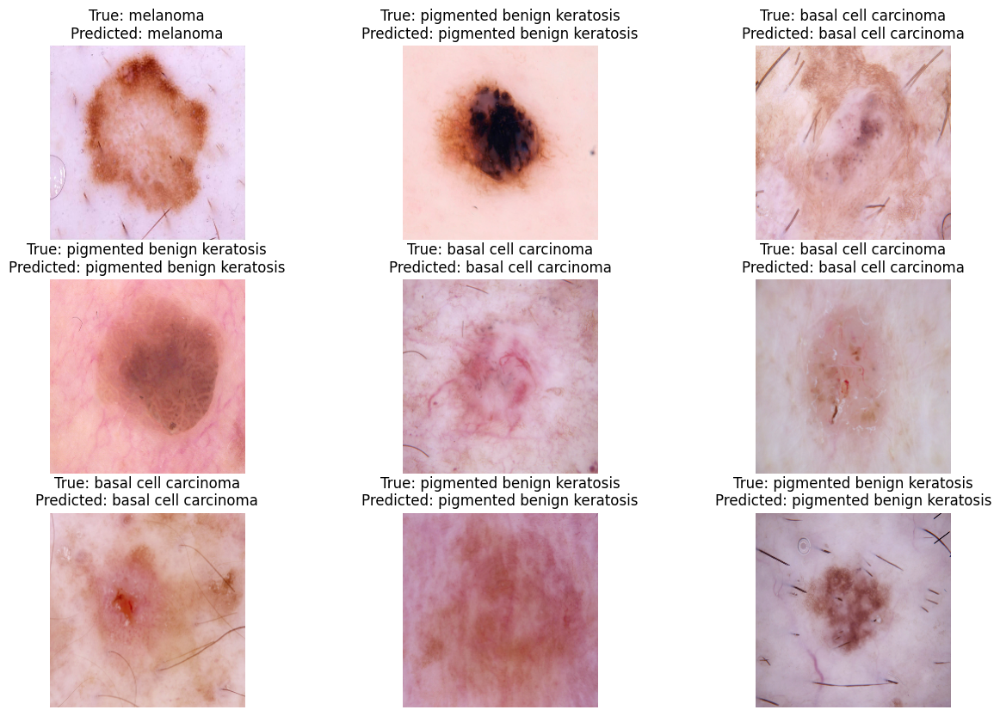

1/1 [==============================] - 0s 34ms/step


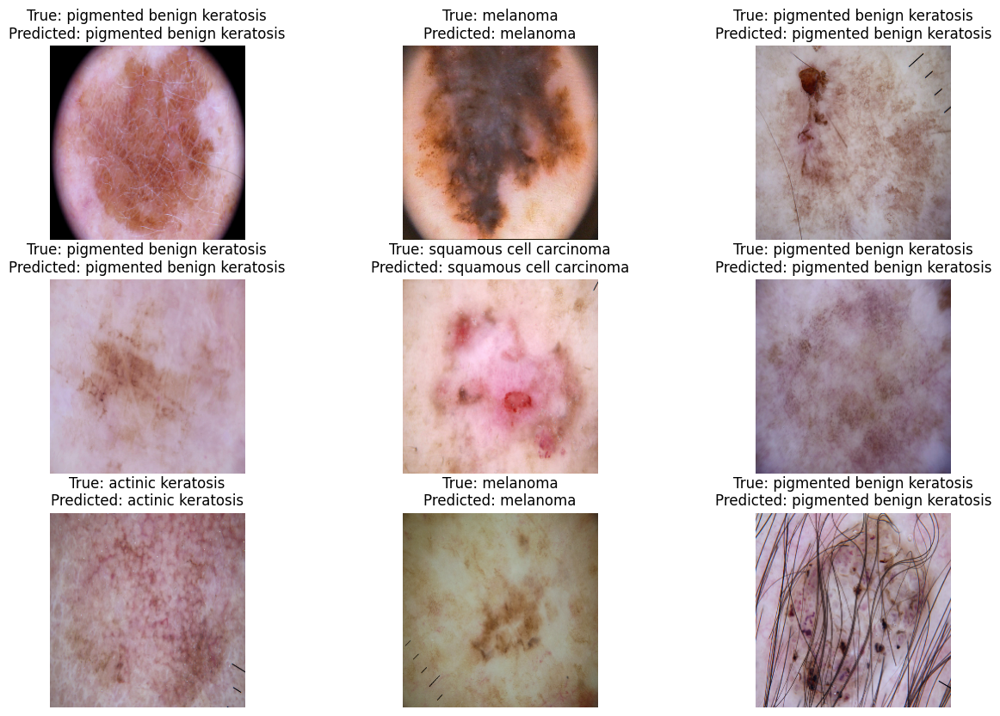

1/1 [==============================] - 0s 42ms/step


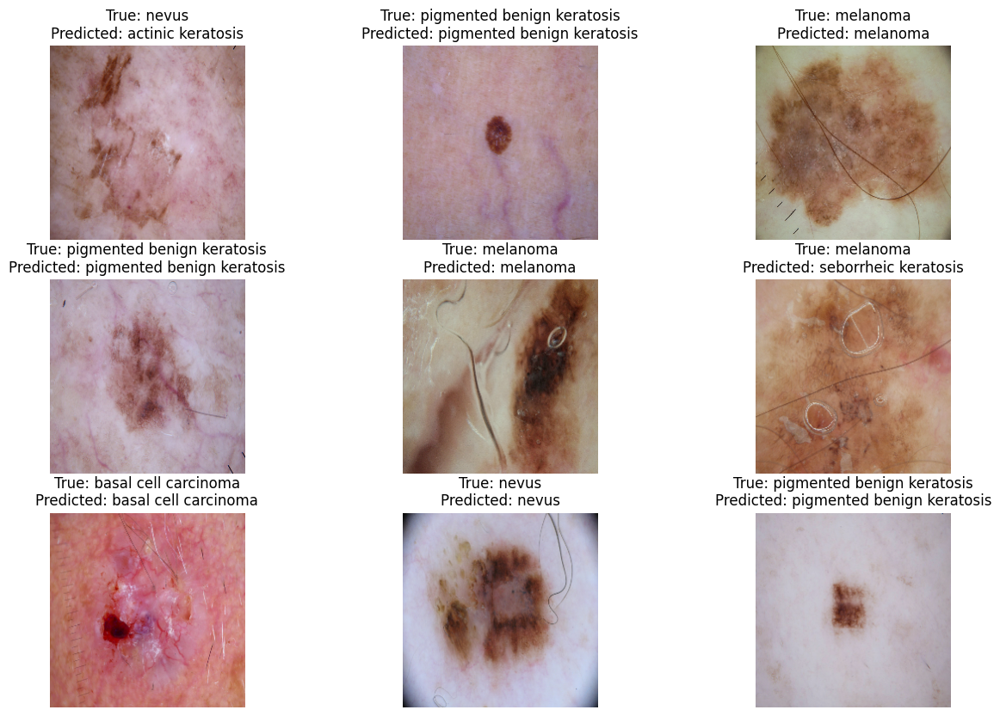

1/1 [==============================] - 0s 37ms/step


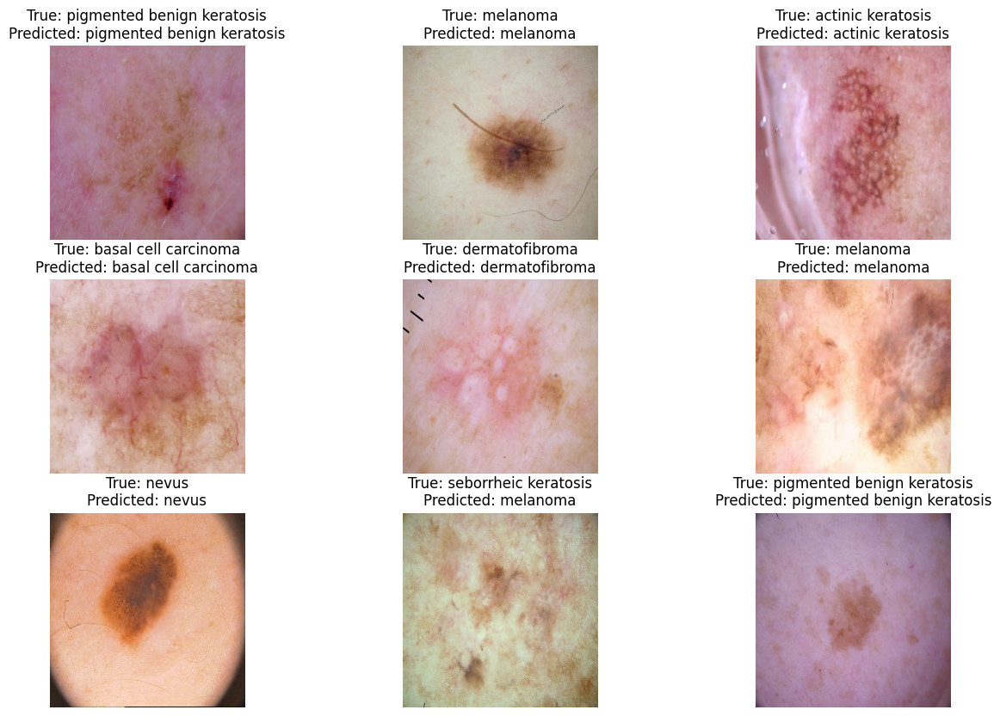

1/1 [==============================] - 0s 43ms/step


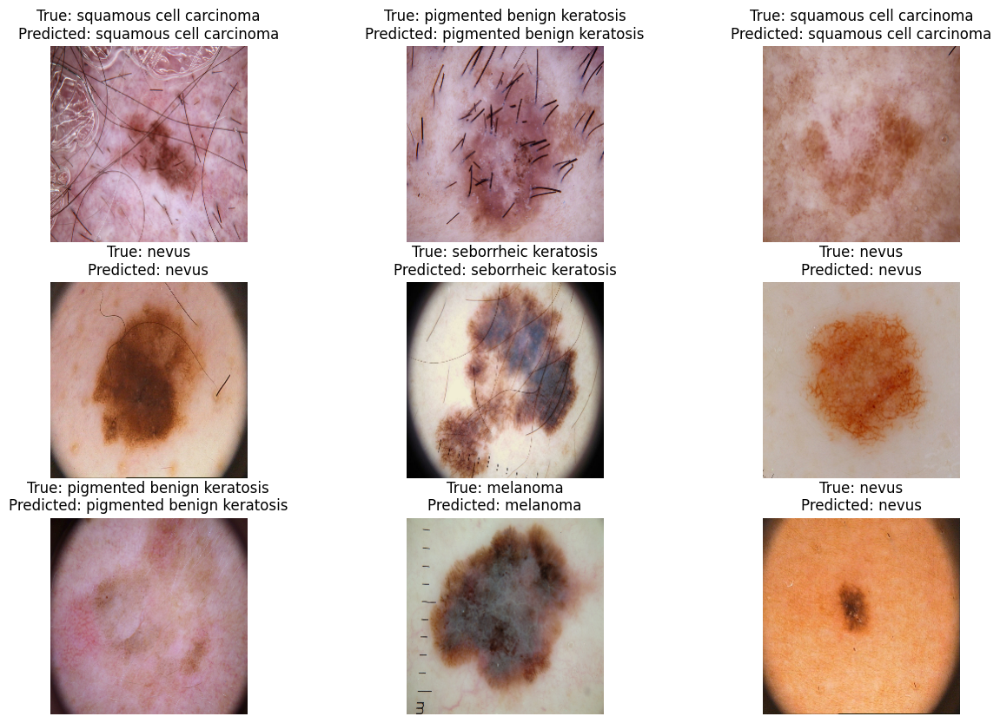

1/1 [==============================] - 0s 47ms/step


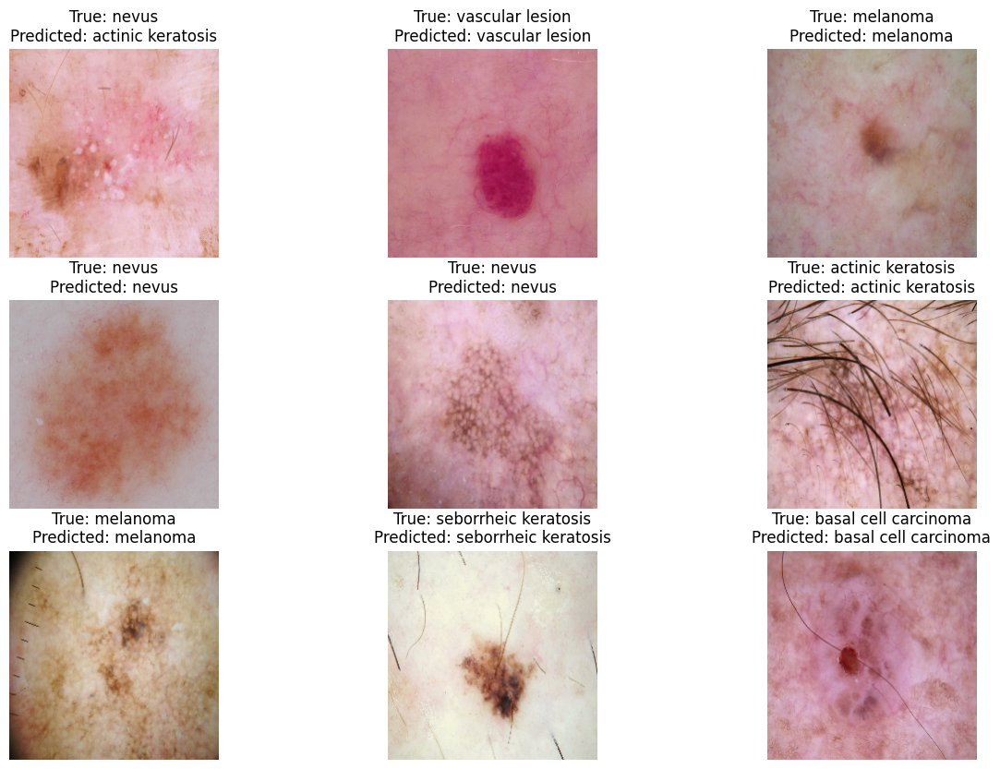

1/1 [==============================] - 0s 38ms/step


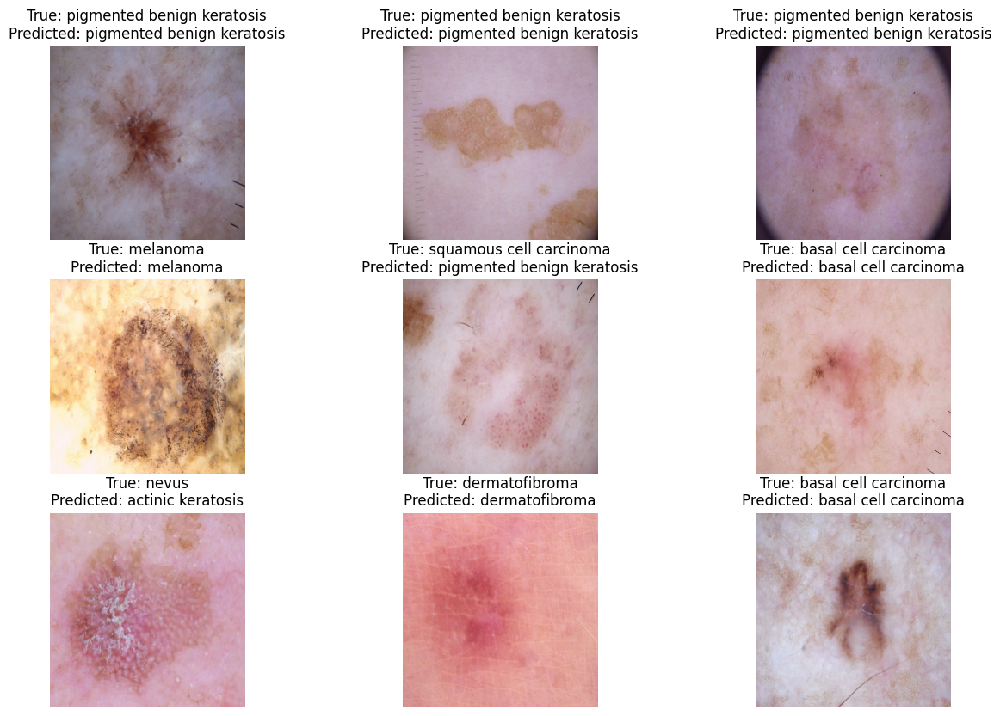

1/1 [==============================] - 0s 203ms/step


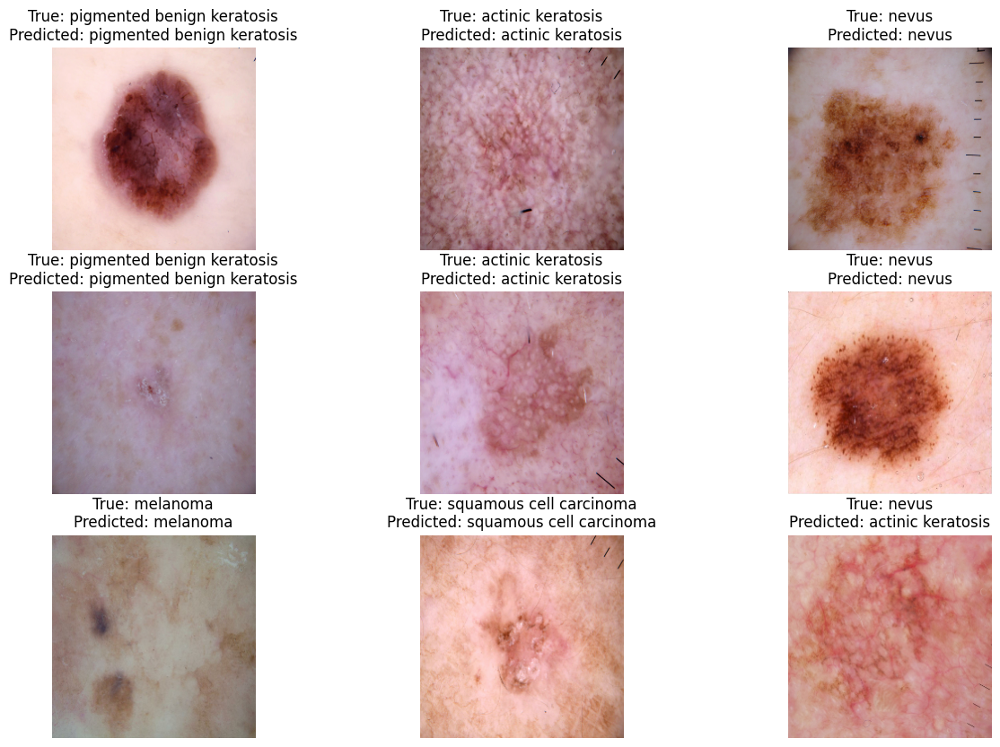

Total 126 images saved where true_label is equal to predicted_label.


In [ ]:
# plt.figure(figsize=(10, 10))

# num_cols
image_count = 0

for images, true_labels in test_ds:  # Iterate through all batches in test_ds
    predicted_class_indices = loaded_model.predict(images)  # Predict the labels for the images
    plt.figure(figsize=(15, 10))
    for i in range(9):  # Display only 9 images to fit the subplot layout
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        true_label = class_names[true_labels[i].numpy()]
        predicted_label = class_names[np.argmax(predicted_class_indices[i])]
        plt.title(f"True: {true_label}\nPredicted: {predicted_label}")
        plt.axis("off")
        image_count += 1
    plt.show()
print(f"Total {image_count} images saved where true_label is equal to predicted_label.")

1/1 [==============================] - 0s 37ms/step


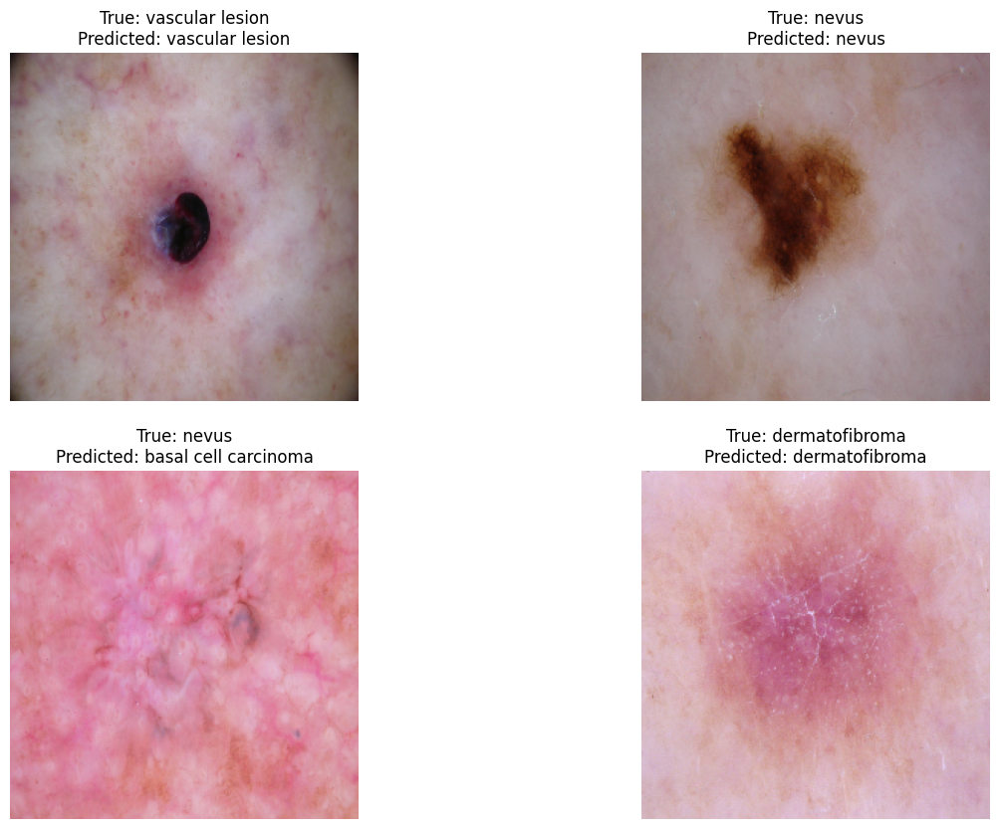

1/1 [==============================] - 0s 32ms/step


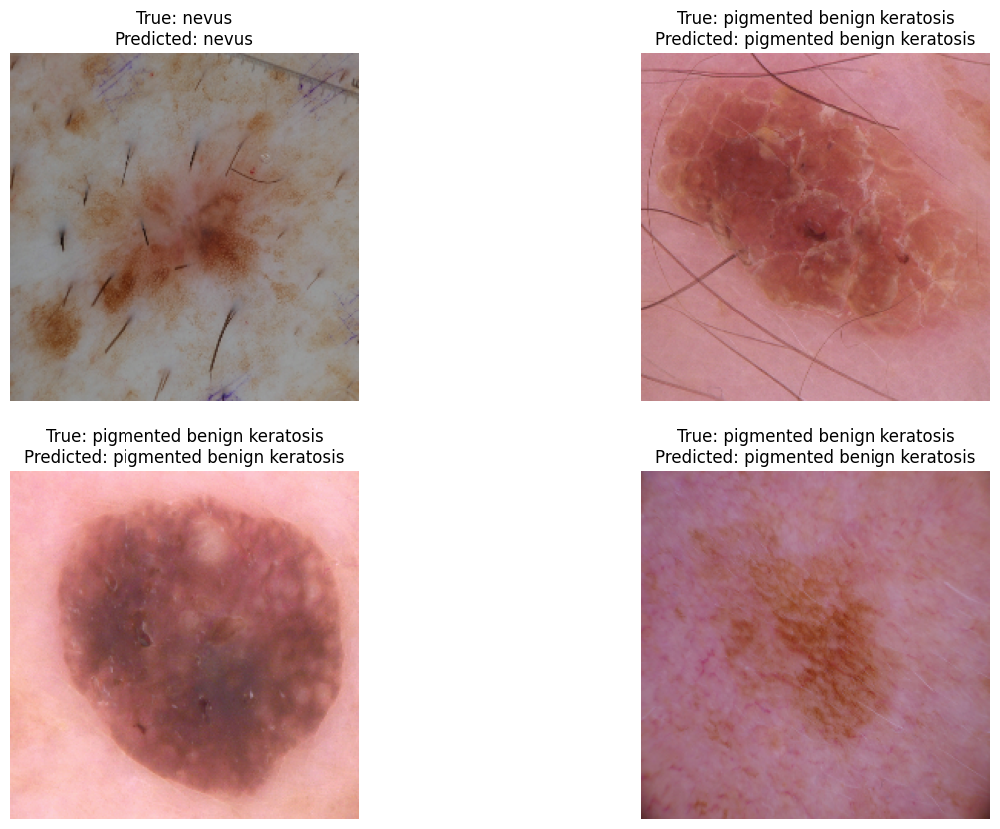

1/1 [==============================] - 0s 37ms/step


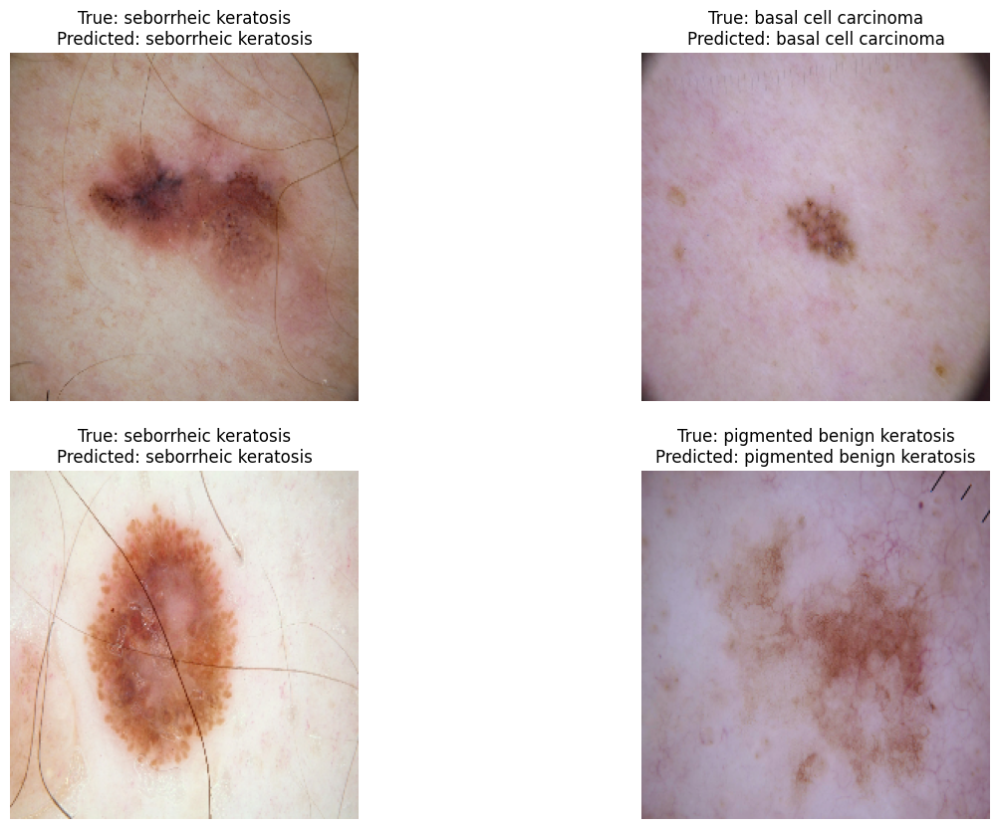

1/1 [==============================] - 0s 33ms/step


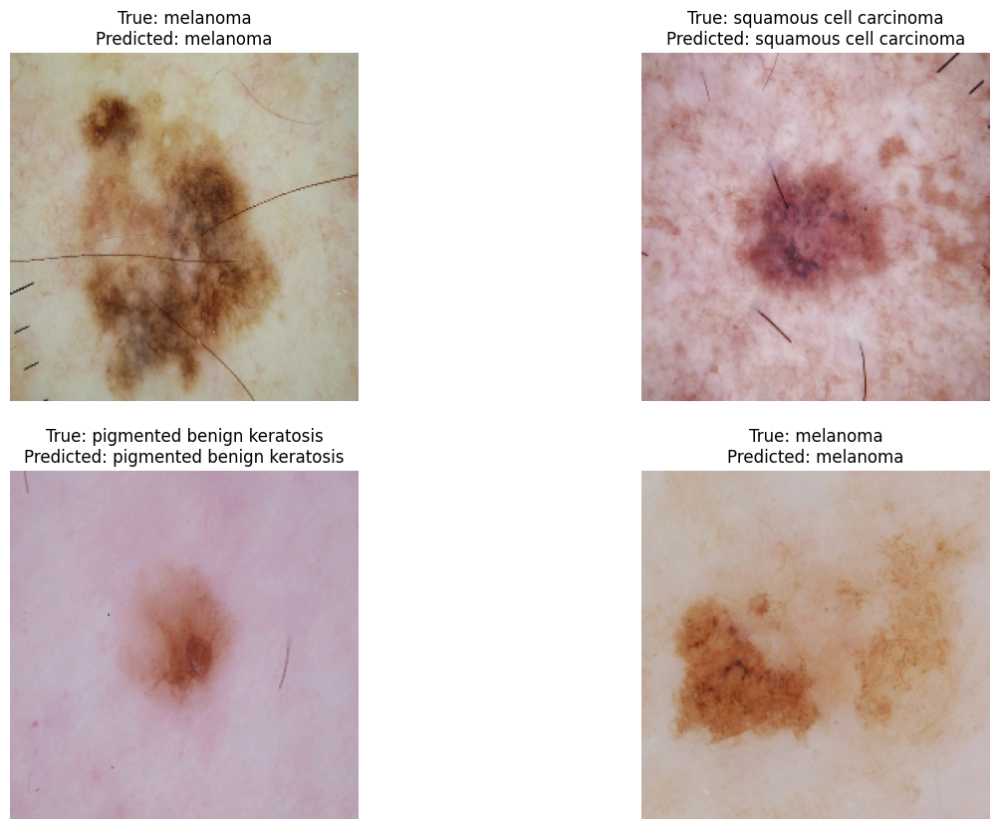

1/1 [==============================] - 0s 86ms/step


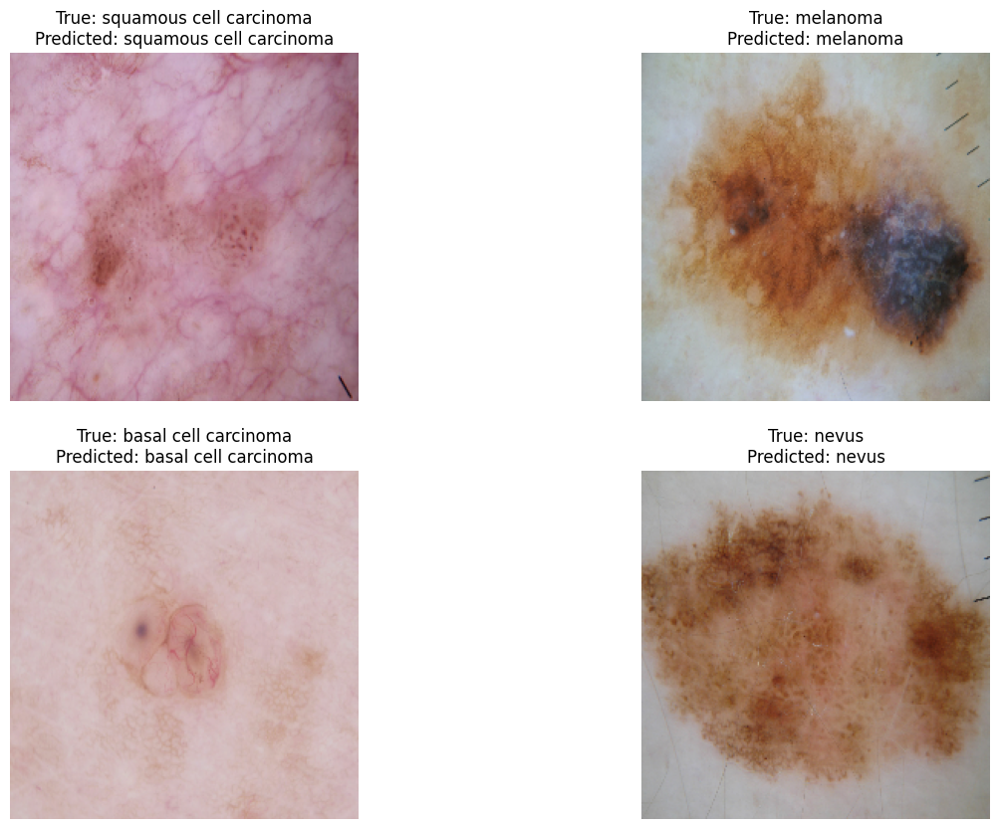

1/1 [==============================] - 0s 51ms/step


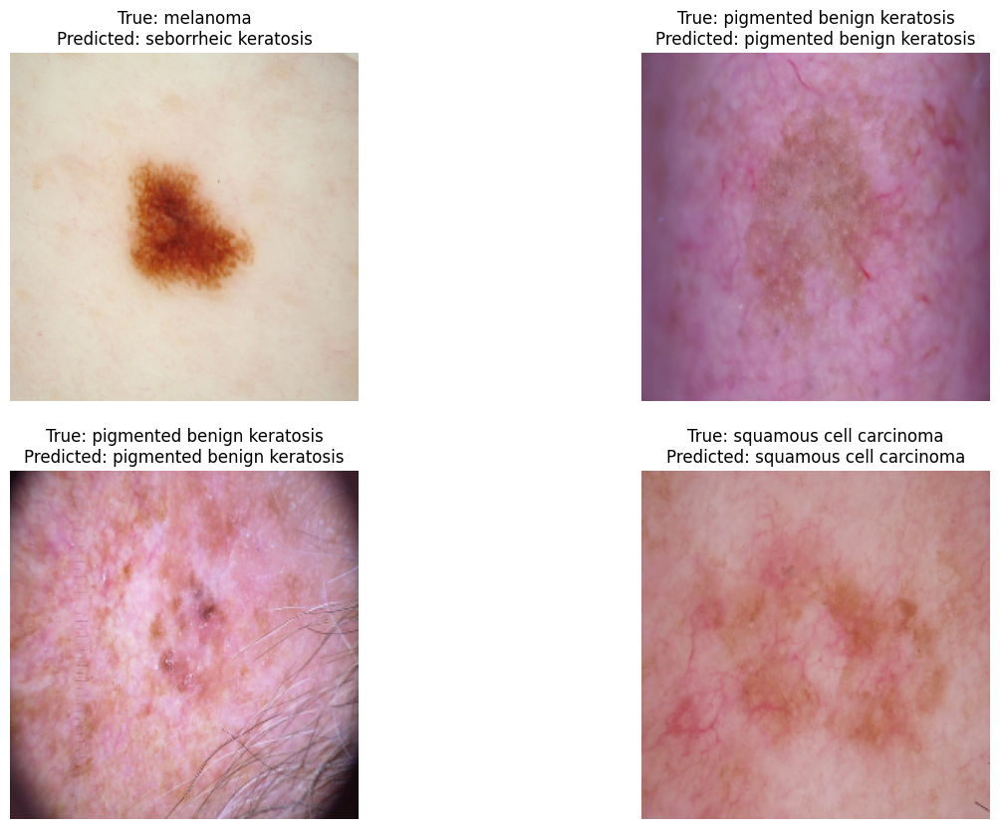

1/1 [==============================] - 0s 44ms/step


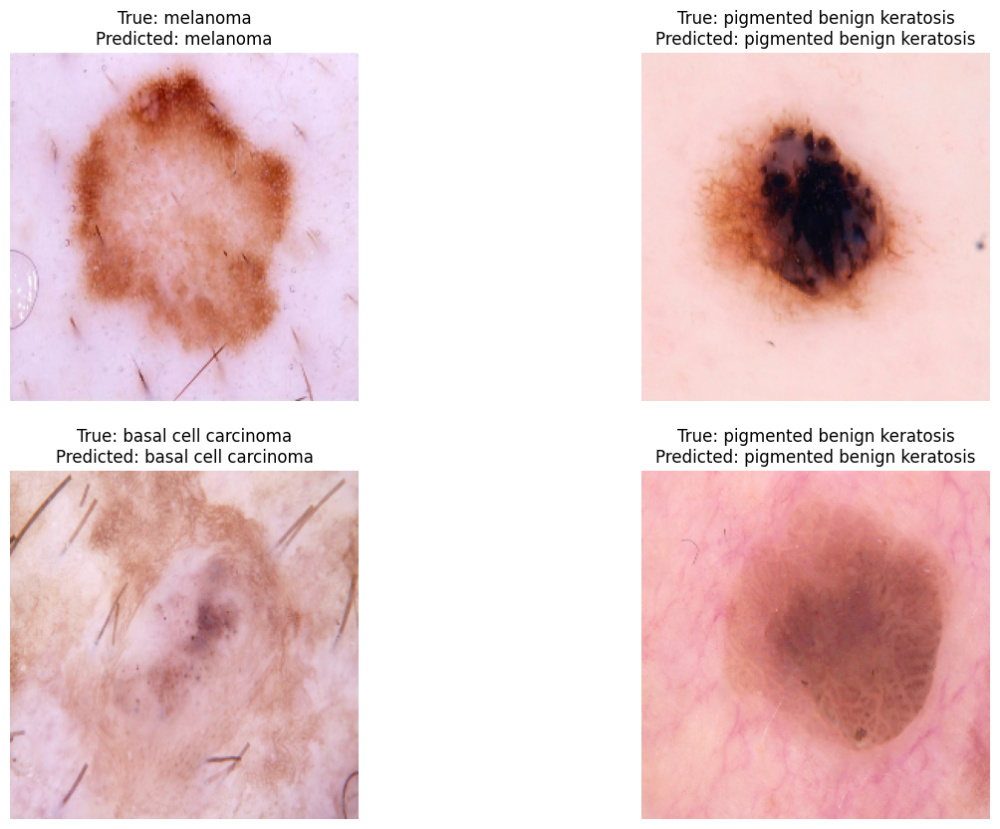

1/1 [==============================] - 0s 34ms/step


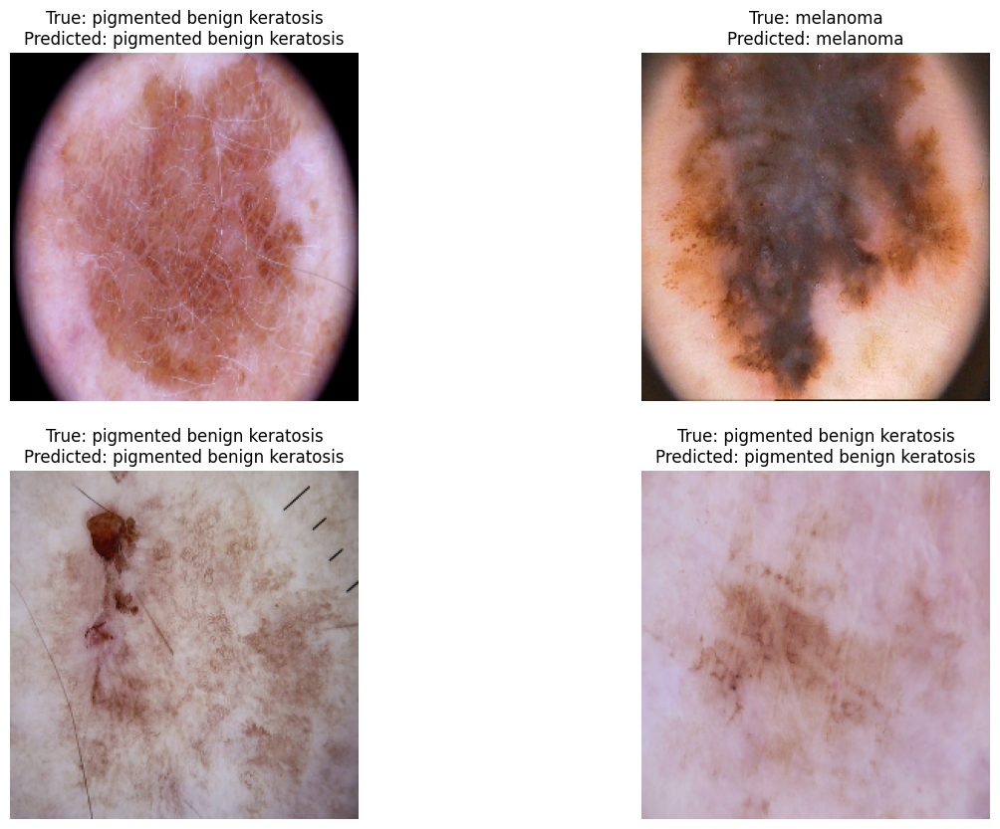

1/1 [==============================] - 0s 41ms/step


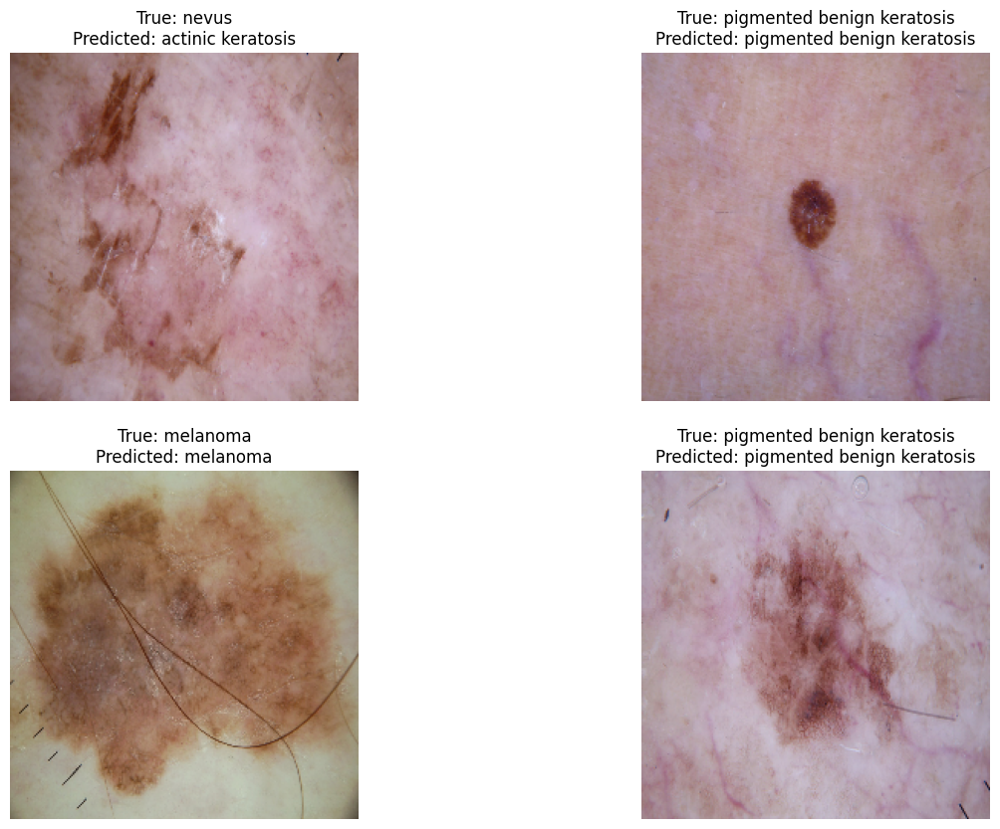

1/1 [==============================] - 0s 33ms/step


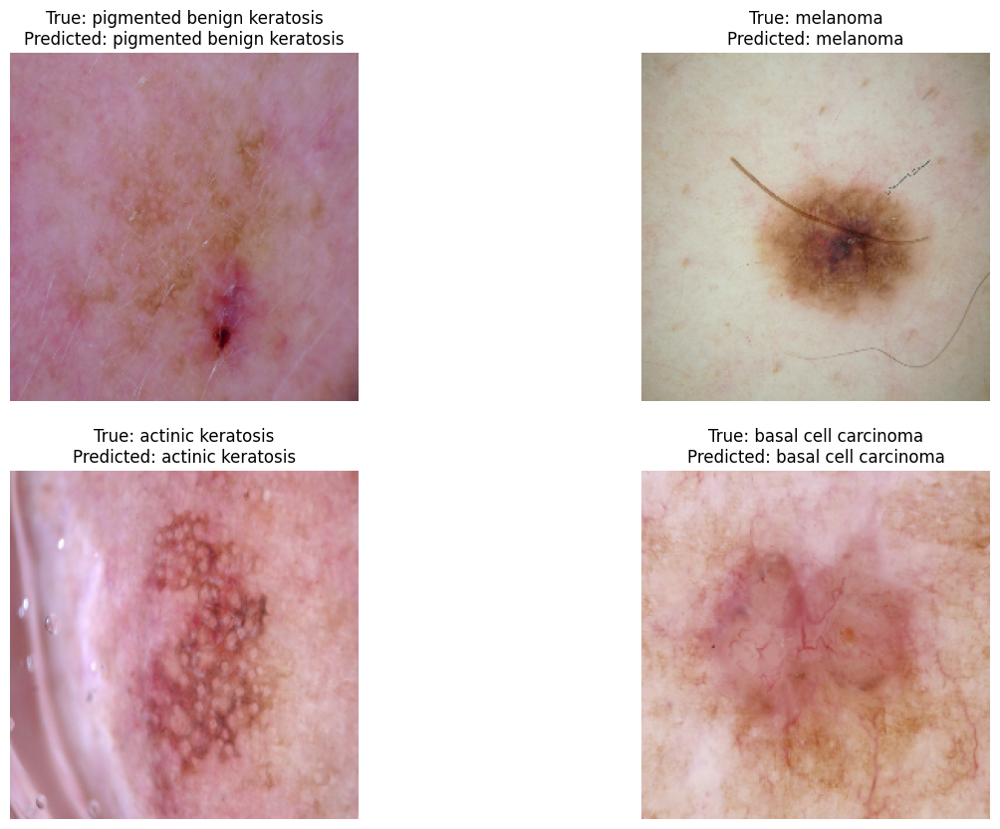

1/1 [==============================] - 0s 44ms/step


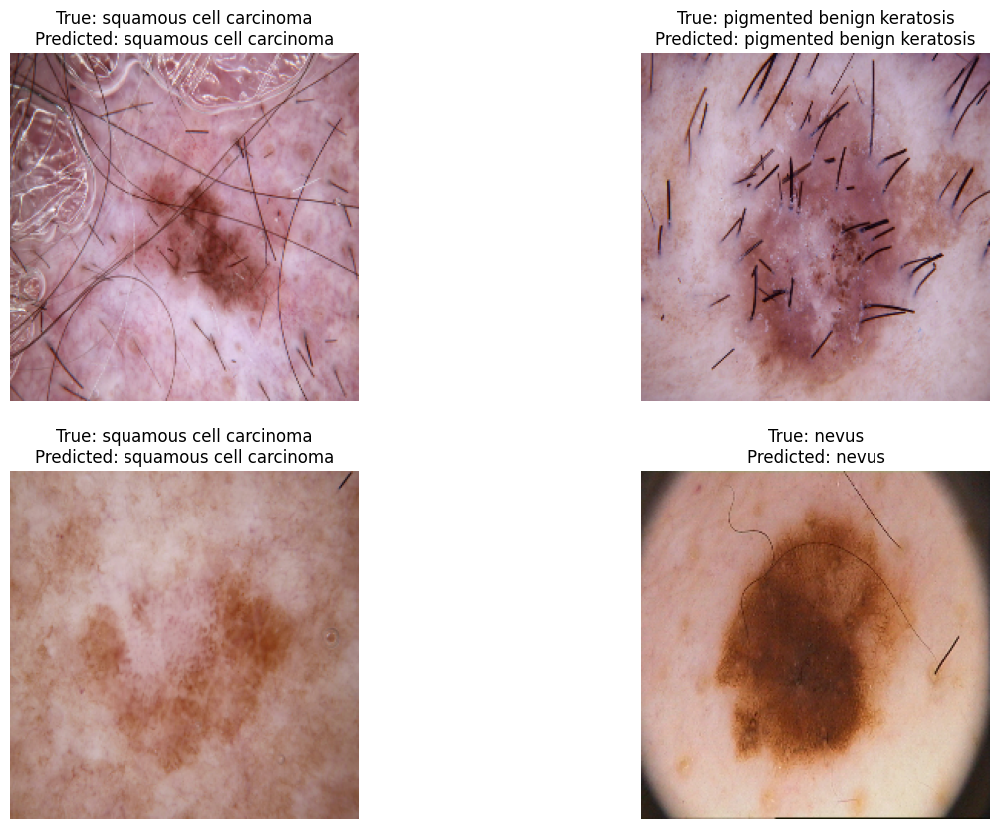

1/1 [==============================] - 0s 52ms/step


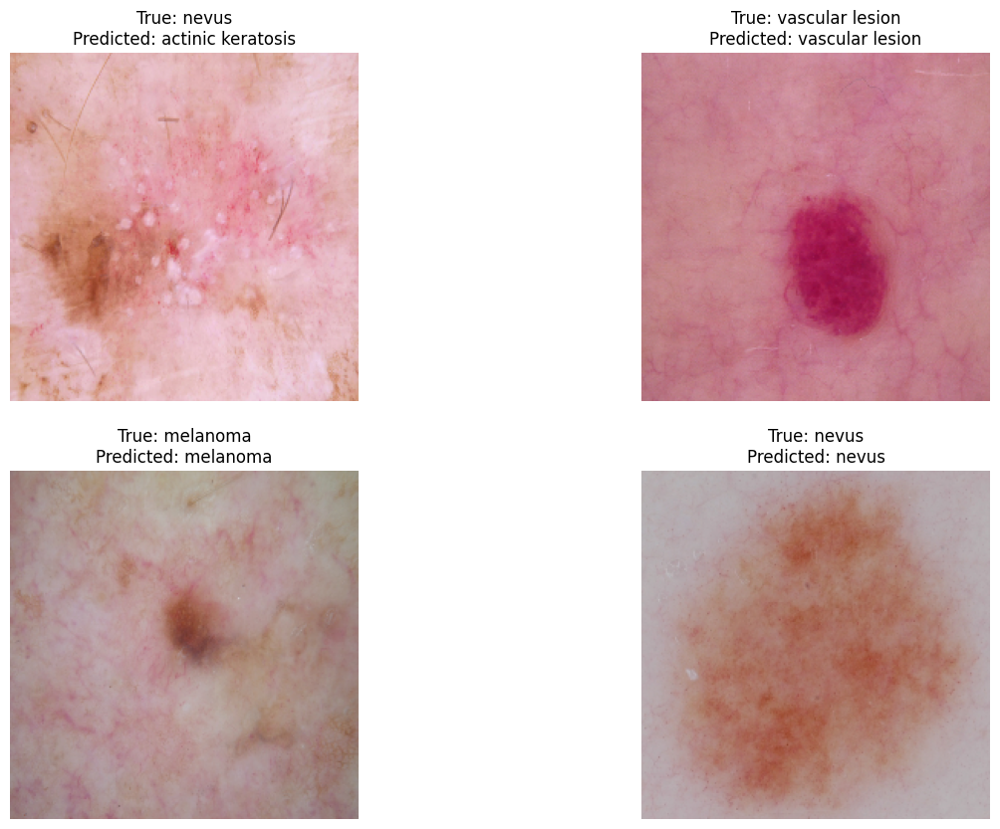

1/1 [==============================] - 0s 35ms/step


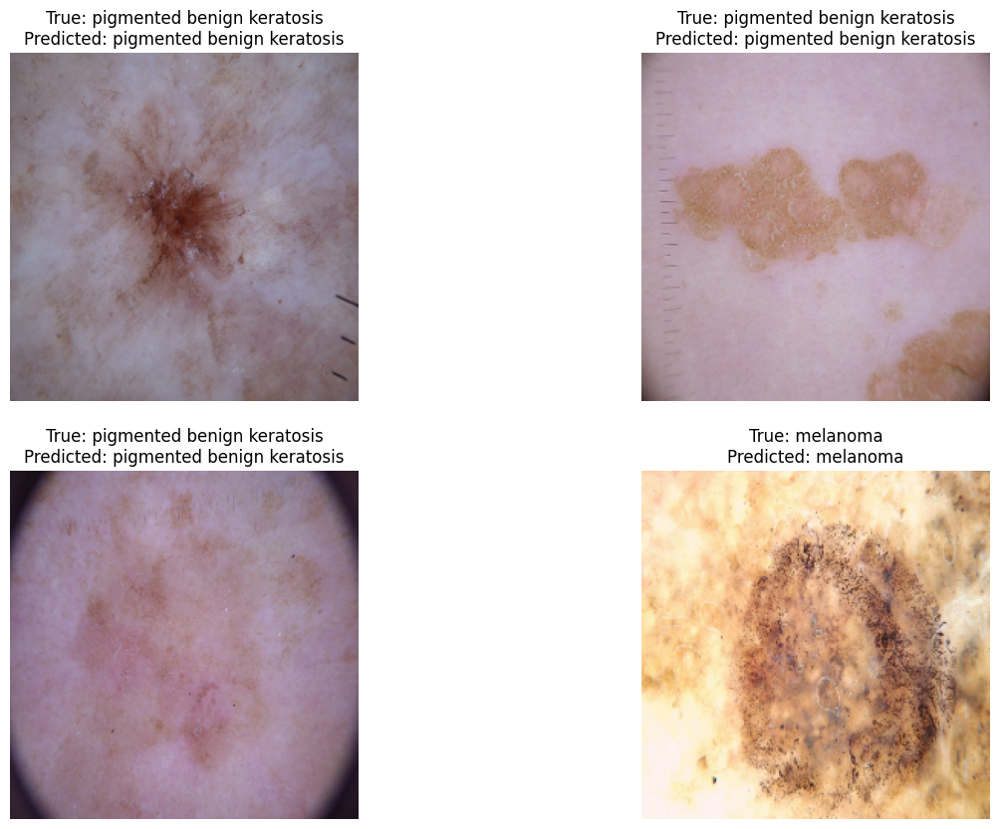

1/1 [==============================] - 0s 34ms/step


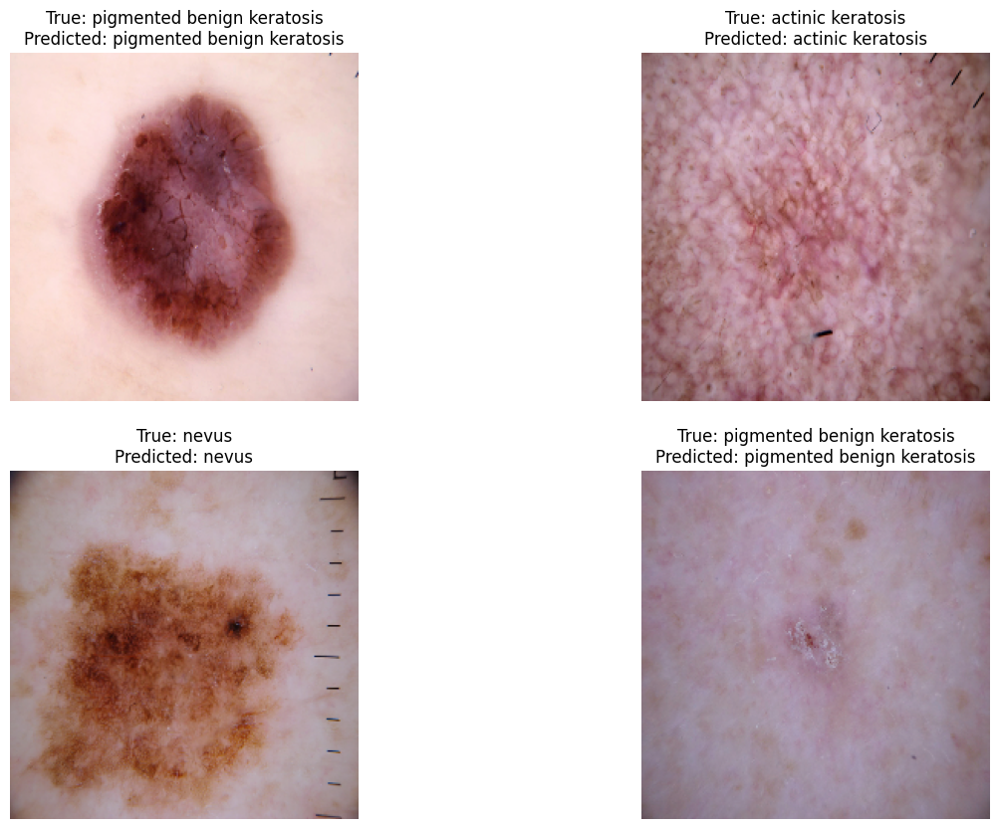

Total 56 images saved where true_label is equal to predicted_label.


In [ ]:
# plt.figure(figsize=(10, 10))

# num_cols
image_count = 0
save_dir = "Test_images"

# Create the directory if it doesn't exist
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
for images, true_labels in test_ds:  # Iterate through all batches in test_ds
    predicted_class_indices = loaded_model.predict(images)  # Predict the labels for the images
    plt.figure(figsize=(15, 10))
    for i in range(4):  # Display only 9 images to fit the subplot layout
        ax = plt.subplot(2, 2, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        true_label = class_names[true_labels[i].numpy()]
        predicted_label = class_names[np.argmax(predicted_class_indices[i])]
        plt.title(f"True: {true_label}\nPredicted: {predicted_label}")
        plt.axis("off")
        folder_path = os.path.join(save_dir, true_label)
        if not os.path.exists(folder_path):
            os.makedirs(folder_path)
        plt.imsave(os.path.join(folder_path, f"image_{i}.png"), images[i].numpy().astype("uint8"))
        image_count += 1
    plt.show()
print(f"Total {image_count} images saved where true_label is equal to predicted_label.")

In [ ]:
!zip -r /content/Test.zip /content/Test_images


  adding: content/Test_images/ (stored 0%)
  adding: content/Test_images/vascular lesion/ (stored 0%)
  adding: content/Test_images/vascular lesion/image_0.png (deflated 0%)
  adding: content/Test_images/vascular lesion/image_1.png (deflated 0%)
  adding: content/Test_images/nevus/ (stored 0%)
  adding: content/Test_images/nevus/image_3.png (deflated 0%)
  adding: content/Test_images/nevus/image_2.png (deflated 0%)
  adding: content/Test_images/nevus/image_0.png (deflated 0%)
  adding: content/Test_images/nevus/image_1.png (deflated 0%)
  adding: content/Test_images/squamous cell carcinoma/ (stored 0%)
  adding: content/Test_images/squamous cell carcinoma/image_3.png (deflated 0%)
  adding: content/Test_images/squamous cell carcinoma/image_2.png (deflated 0%)
  adding: content/Test_images/squamous cell carcinoma/image_0.png (deflated 0%)
  adding: content/Test_images/squamous cell carcinoma/image_1.png (deflated 0%)
  adding: content/Test_images/seborrheic keratosis/ (stored 0%)
  addi

In [ ]:
import tensorflow as tf
print("TensorFlow version:", tf.__version__)

import keras
print("Keras version:", keras.__version__)

TensorFlow version: 2.15.0
Keras version: 2.15.0


In [ ]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Assuming loaded_model contains the trained CNN model

# Evaluate the model on the test dataset
loss, accuracy = loaded_model.evaluate(test_ds)

# Get the true labels and predicted labels
true_labels = []
predicted_labels = []

for images, labels in test_ds:
    predicted_probabilities = loaded_model.predict(images)
    predicted_classes = np.argmax(predicted_probabilities, axis=1)
    true_labels.extend(labels.numpy())
    predicted_labels.extend(predicted_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Calculate and display the classification report
print("Classification Report:")
print(classification_report(true_labels, predicted_labels))

# Calculate and display the confusion matrix
print("Confusion Matrix:")
print(confusion_matrix(true_labels, predicted_labels))


1/1 [==============================] - 0s 45ms/step
Classification Report:
              precision    recall  f1-score   support

           0       0.64      0.95      0.76        22
           1       0.96      1.00      0.98        67
           2       1.00      0.94      0.97        18
           3       0.90      0.87      0.89        86
           4       0.89      0.79      0.83        80
           5       0.96      1.00      0.98        92
           6       0.71      0.63      0.67        19
           7       1.00      0.90      0.95        39
           8       0.96      1.00      0.98        24

    accuracy                           0.91       447
   macro avg       0.89      0.90      0.89       447
weighted avg       0.91      0.91      0.91       447

Confusion Matrix:
[[21  0  0  0  1  0  0  0  0]
 [ 0 67  0  0  0  0  0  0  0]
 [ 0  0 17  0  0  1  0  0  0]
 [ 0  0  0 75  5  1  5  0  0]
 [12  2  0  2 63  0  0  0  1]
 [ 0  0  0  0  0 92  0  0  0]
 [ 0  0  0  6  1  0 12